In [21]:
import cv2
import numpy as np
import os

In [22]:
def load_yolo_model(cfg_path, weights_path, names_path):
    net = cv2.dnn.readNet(weights_path, cfg_path)
    with open(names_path, 'r') as f:
        classes = f.read().strip().split('\n')
    return net, classes

# Paths to YOLO files
cfg_path = 'yolov3.cfg'
weights_path = 'yolov3.weights'
names_path = 'coco.names'

# Load YOLO model
yolo_model, classes = load_yolo_model(cfg_path, weights_path, names_path)



In [23]:
def detect_objects(net, classes, frame, conf_threshold=0.5, nms_threshold=0.4):
    blob = cv2.dnn.blobFromImage(frame, 1/255.0, (416, 416), swapRB=True, crop=False)
    net.setInput(blob)
    layer_names = net.getLayerNames()
    output_layers = [layer_names[i - 1] for i in net.getUnconnectedOutLayers()]
    detections = net.forward(output_layers)

    boxes = []
    confidences = []
    class_ids = []
    h, w = frame.shape[:2]

    for output in detections:
        for detection in output:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]
            if confidence > conf_threshold:
                center_x = int(detection[0] * w)
                center_y = int(detection[1] * h)
                width = int(detection[2] * w)
                height = int(detection[3] * h)
                x = int(center_x - width / 2)
                y = int(center_y - height / 2)
                boxes.append([x, y, x + width, y + height])
                confidences.append(float(confidence))
                class_ids.append(class_id)

    indices = cv2.dnn.NMSBoxes(boxes, confidences, conf_threshold, nms_threshold)
    filtered_boxes = []
    if len(indices) > 0:
        for i in indices.flatten():
            box = boxes[i]
            filtered_boxes.append(box + [confidences[i], class_ids[i]])

    return filtered_boxes

In [24]:
import matplotlib.pyplot as plt
import seaborn as sns

def visualize_spatial_temporal_features(spatial_adj_matrices, temporal_adj_matrices, frame_features, box_features_list):
    # Visualize a spatial adjacency matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(spatial_adj_matrices[0], annot=False, cmap='coolwarm')
    plt.title('Spatial Adjacency Matrix - Frame 0')
    plt.xlabel('Object Index')
    plt.ylabel('Object Index')
    plt.show()

    # Visualize a temporal adjacency matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(temporal_adj_matrices[1], annot=False, cmap='coolwarm')
    plt.title('Temporal Adjacency Matrix - Frame 1')
    plt.xlabel('Object Index (Current Frame)')
    plt.ylabel('Object Index (Previous Frame)')
    plt.show()

    # Visualize the distribution of frame features
    plt.figure(figsize=(10, 4))
    plt.plot(frame_features[0], color='blue')
    plt.title('Frame Features Distribution - Frame 0')
    plt.xlabel('Feature Index')
    plt.ylabel('Feature Value')
    plt.show()

    # Visualize the distribution of box features for a specific frame
    plt.figure(figsize=(10, 4))
    for i in range(len(box_features_list[0])):
        plt.plot(box_features_list[0][i], label=f'Box {i}')
    plt.title('Box Features Distribution - Frame 0')
    plt.xlabel('Feature Index')
    plt.ylabel('Feature Value')
    plt.legend(loc='upper right', bbox_to_anchor=(1.15, 1))
    plt.show()

# Example usage with generated data from the process_video function
# final_output, detections, label, frame_id = process_video(video_path, yolo_model, classes, output_dir)

# Assuming you have already generated the data:
# Here we would call the visualization with the actual matrices and features generated

In [25]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def overlay_features_on_image(frame, boxes, spatial_adj_matrix=None, temporal_adj_matrix=None):
    # Draw bounding boxes
    for i, box in enumerate(boxes):
        x1, y1, x2, y2, _, class_id = box
        label = f"ID: {int(class_id)}"
        cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)
        cv2.putText(frame, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)
        
        # Overlay spatial adjacency as a transparency if provided
        if spatial_adj_matrix is not None:
            # Normalize alpha value between 0 and 1
            alpha = np.clip(spatial_adj_matrix[i].mean(), 0, 1)
            overlay = frame.copy()
            cv2.rectangle(overlay, (x1, y1), (x2, y2), (0, 0, 255), -1)
            # Apply the weighted overlay with a single alpha value
            cv2.addWeighted(overlay, alpha, frame, 1 - alpha, 0, frame)
    
    # Optionally, draw connections between objects for temporal adjacency
    if temporal_adj_matrix is not None and len(boxes) > 1:
        for i in range(len(boxes)):
            for j in range(i+1, len(boxes)):
                if temporal_adj_matrix[i, j] > 0.5:  # Arbitrary threshold for visualization
                    x1, y1 = (boxes[i][0] + boxes[i][2]) // 2, (boxes[i][1] + boxes[i][3]) // 2
                    x2, y2 = (boxes[j][0] + boxes[j][2]) // 2, (boxes[j][1] + boxes[j][3]) // 2
                    cv2.line(frame, (x1, y1), (x2, y2), (255, 0, 0), 2)

    return frame

def visualize_overlaid_features(video_path, yolo_model, classes, output_dir):
    cap = cv2.VideoCapture(video_path)
    frame_count = 0

    while cap.isOpened() and frame_count < 50:
        ret, frame = cap.read()
        if not ret:
            break

        boxes = detect_objects(yolo_model, classes, frame)
        if len(boxes) > 19:
            boxes = boxes[:19]  # Ensure only 19 boxes are considered
        
        spatial_adj_matrix = np.zeros((len(boxes), len(boxes)))
        for i in range(len(boxes)):
            for j in range(len(boxes)):
                if i != j:
                    ci = ((boxes[i][0] + boxes[i][2]) / 2, (boxes[i][1] + boxes[i][3]) / 2)
                    cj = ((boxes[j][0] + boxes[j][2]) / 2, (boxes[j][1] + boxes[j][3]) / 2)
                    spatial_adj_matrix[i, j] = np.exp(-np.linalg.norm(np.array(ci) - np.array(cj)))

        # For simplicity, assume the temporal matrix is similar to the spatial one in this example
        temporal_adj_matrix = spatial_adj_matrix
        
        frame_with_overlay = overlay_features_on_image(frame, boxes, spatial_adj_matrix, temporal_adj_matrix)
        
        plt.figure(figsize=(10, 6))
        plt.imshow(cv2.cvtColor(frame_with_overlay, cv2.COLOR_BGR2RGB))
        plt.title(f'Frame {frame_count} with Feature Overlays')
        plt.axis('off')
        plt.show()

        frame_count += 1

    cap.release()

# Example usage:
# visualize_overlaid_features('path_to_video.mp4', yolo_model, classes, 'output_directory')

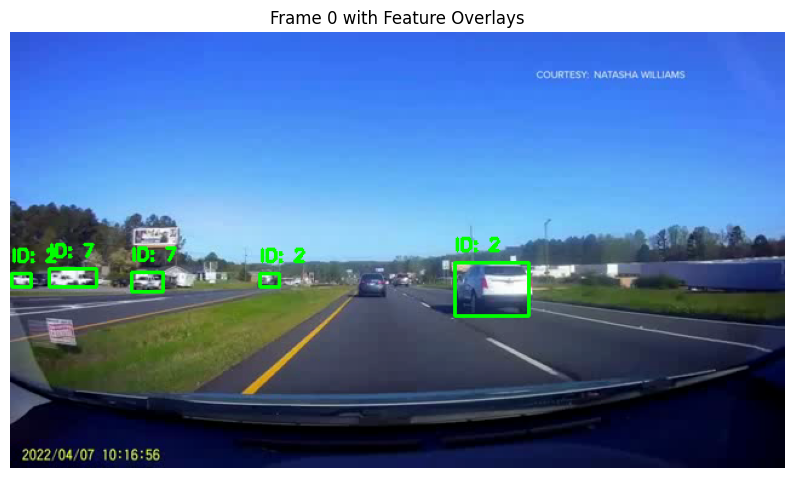

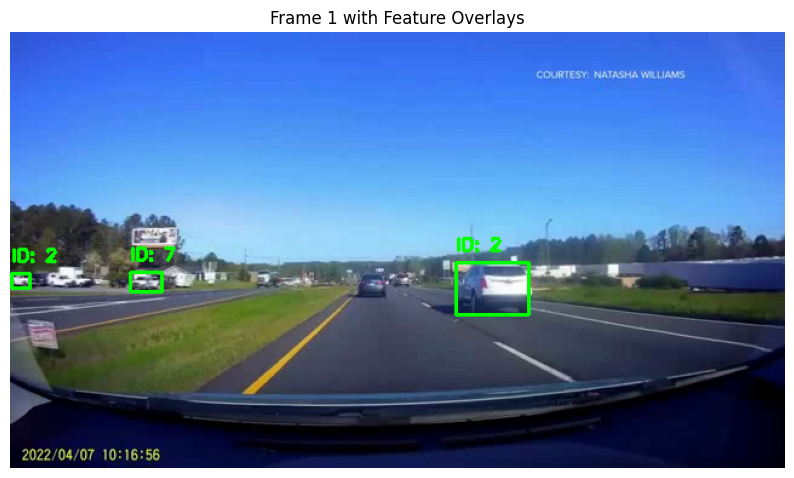

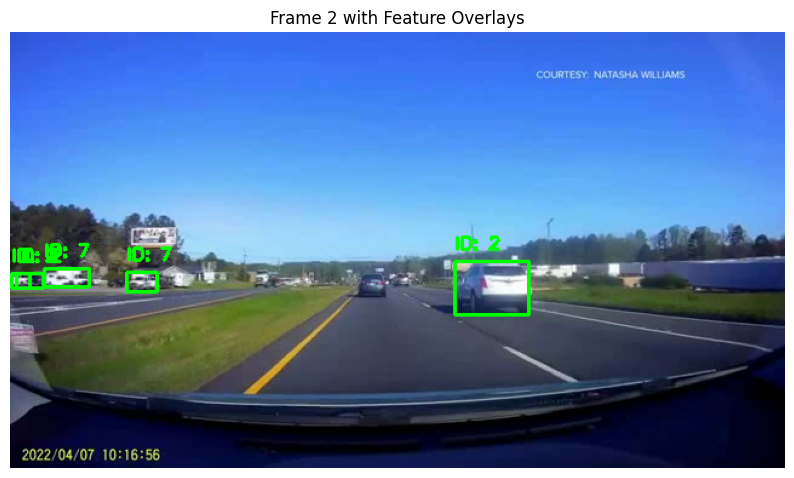

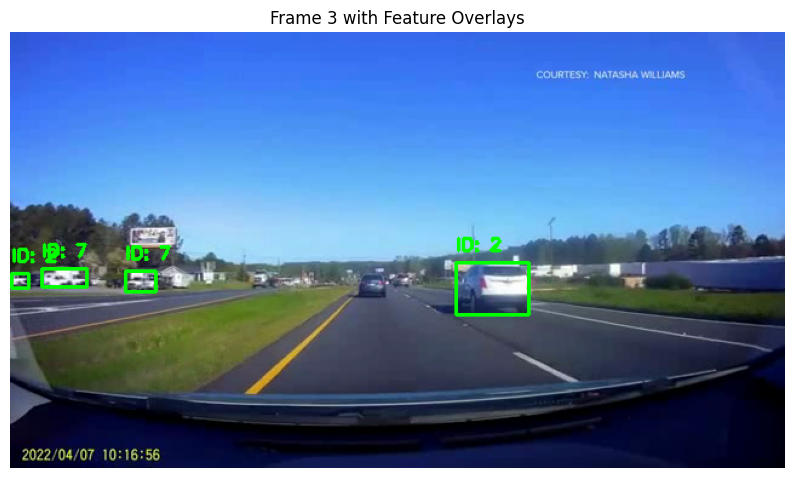

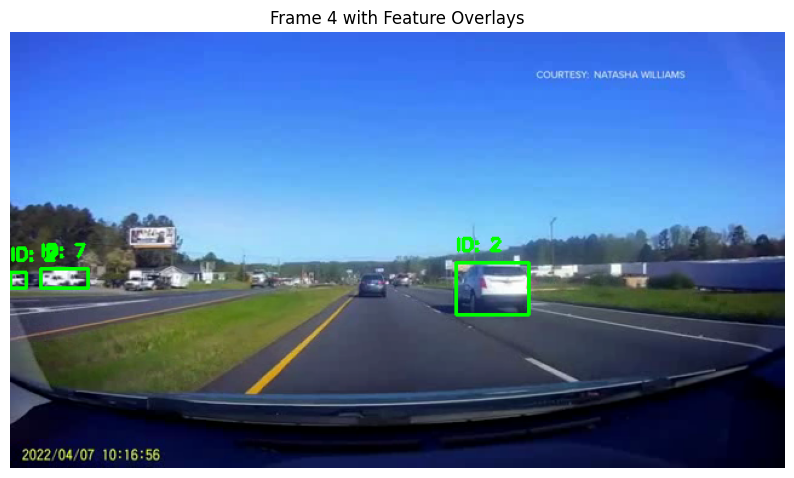

...

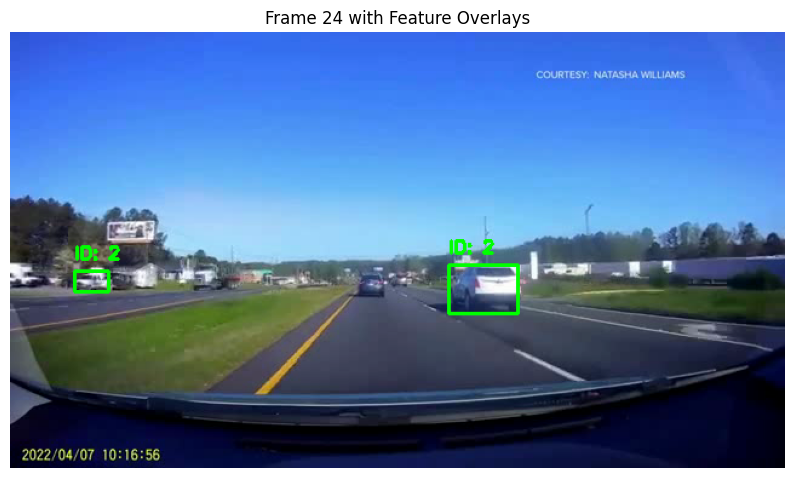

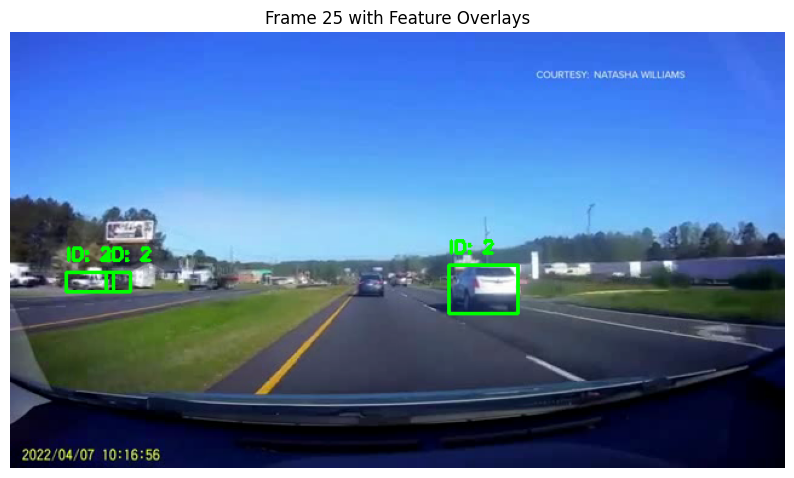

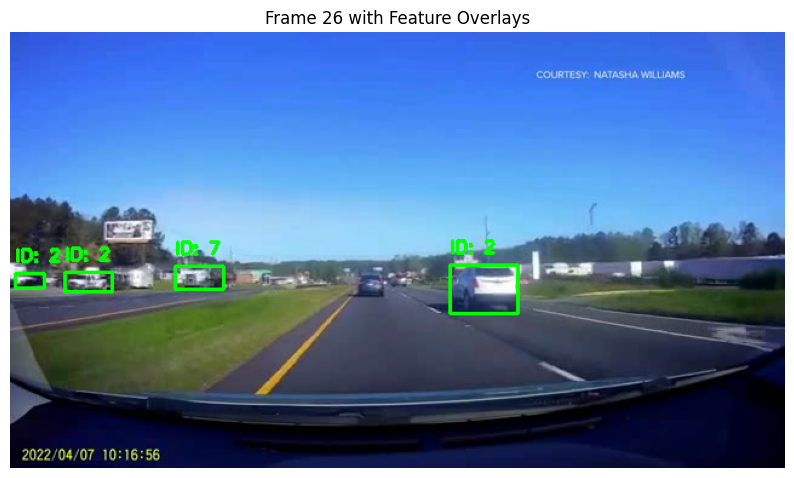

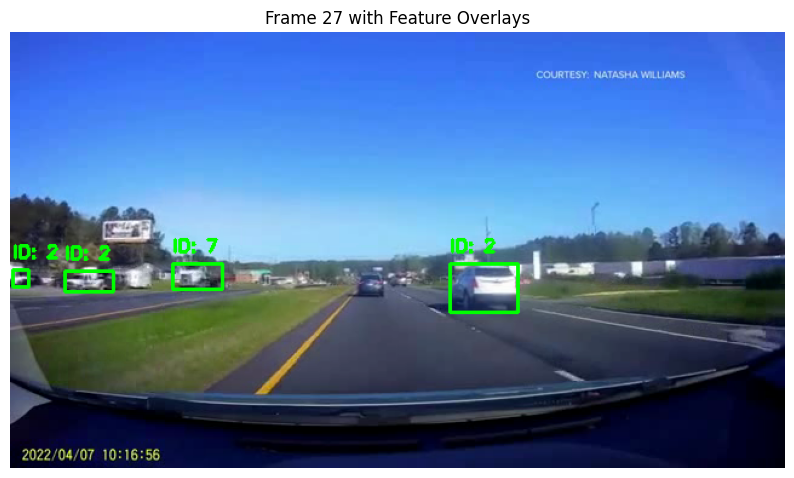

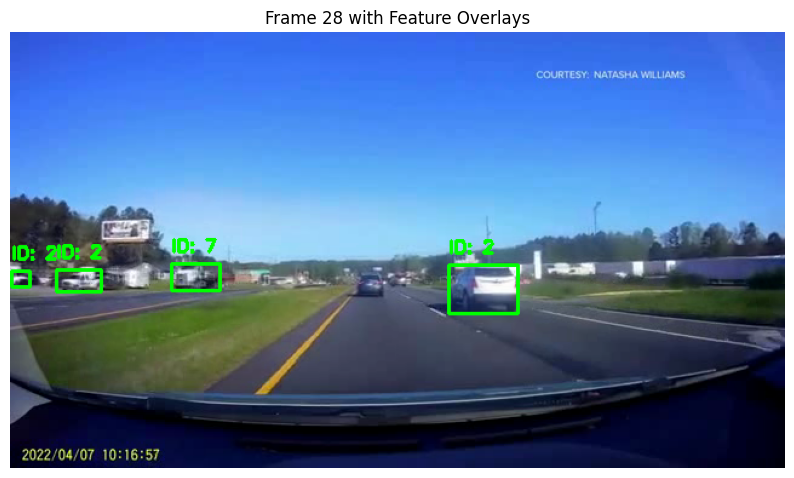

KeyboardInterrupt: 

In [26]:
visualize_overlaid_features('/Users/punsisikiridana/Documents/University_Education/MSc/SEMESTER_2/IN24_S2_CS5801_Advanced_AI/Project/GRAPH/Graph-Graph/data_preparation/input_clips/negative/clip_0000.mp4',yolo_model, classes, 'output_directory')

In [30]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import random

def overlay_spatial_features(frame, boxes, spatial_adj_matrix):
    # Draw bounding boxes with spatial feature intensity
    for i, box in enumerate(boxes):
        x1, y1, x2, y2, _, class_id = box
        label = f"ID: {int(class_id)}"
        # Calculate the mean spatial adjacency for the object
        alpha = np.clip(spatial_adj_matrix[i].mean(), 0, 1)
        color = (0, int(255 * (1 - alpha)), int(255 * alpha))  # Color transitions from green to blue

        cv2.rectangle(frame, (x1, y1), (x2, y2), color, 2)
        cv2.putText(frame, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)
    
    return frame

def overlay_temporal_features(frame, boxes_current, boxes_previous, temporal_adj_matrix):
    # Draw connections between objects in the current and previous frames
    for i, box in enumerate(boxes_current):
        x1, y1 = (box[0] + box[2]) // 2, (box[1] + box[3]) // 2
        for j, prev_box in enumerate(boxes_previous):
            x2, y2 = (prev_box[0] + prev_box[2]) // 2, (prev_box[1] + prev_box[3]) // 2
            if temporal_adj_matrix[i, j] > 0.5:  # Arbitrary threshold for visualization
                thickness = int(5 * temporal_adj_matrix[i, j])  # Line thickness based on similarity
                cv2.line(frame, (x1, y1), (x2, y2), (255, 0, 0), thickness)
    
    return frame

def visualize_spatial_temporal_features(video_path, yolo_model, classes, output_dir):
    cap = cv2.VideoCapture(video_path)
    frame_count = 0
    previous_boxes = None

    while cap.isOpened() and frame_count < 50:
        ret, frame = cap.read()
        if not ret:
            break

        boxes = detect_objects(yolo_model, classes, frame)
        if len(boxes) > 19:
            boxes = boxes[:19]  # Ensure only 19 boxes are considered
        
        spatial_adj_matrix = np.zeros((len(boxes), len(boxes)))
        for i in range(len(boxes)):
            for j in range(len(boxes)):
                if i != j:
                    ci = ((boxes[i][0] + boxes[i][2]) / 2, (boxes[i][1] + boxes[i][3]) / 2)
                    cj = ((boxes[j][0] + boxes[j][2]) / 2, (boxes[j][1] + boxes[j][3]) / 2)
                    spatial_adj_matrix[i, j] = np.exp(-np.linalg.norm(np.array(ci) - np.array(cj)))

        frame_with_spatial = overlay_spatial_features(frame.copy(), boxes, spatial_adj_matrix)
        
        if previous_boxes is not None:
            temporal_adj_matrix = np.zeros((len(boxes), len(previous_boxes)))
            for i in range(len(boxes)):
                for j in range(len(previous_boxes)):
                    temporal_adj_matrix[i, j] = np.random.rand()  # Placeholder for actual similarity calculation
            frame_with_temporal = overlay_temporal_features(frame_with_spatial, boxes, previous_boxes, temporal_adj_matrix)
        else:
            frame_with_temporal = frame_with_spatial
        
        plt.figure(figsize=(10, 6))
        plt.imshow(cv2.cvtColor(frame_with_temporal, cv2.COLOR_BGR2RGB))
        plt.title(f'Frame {frame_count} with Spatial and Temporal Features')
        plt.axis('off')
        #plt.show()
        plt.savefig("/Users/punsisikiridana/Documents/University_Education/MSc/SEMESTER_2/IN24_S2_CS5801_Advanced_AI/Project/GRAPH/Graph-Graph/data_preparation/temporal_features/{}.png".format(str(random.randint(1,1000))))
        previous_boxes = boxes
        frame_count += 1

    cap.release()

# Example usage:
# visualize_spatial_temporal_features('path_to_video.mp4', yolo_model, classes, 'output_directory')

/var/folders/d3/mb3yqvls6894k9653zg1_86m0000gp/T/ipykernel_29690/540372744.py:65: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(10, 6))


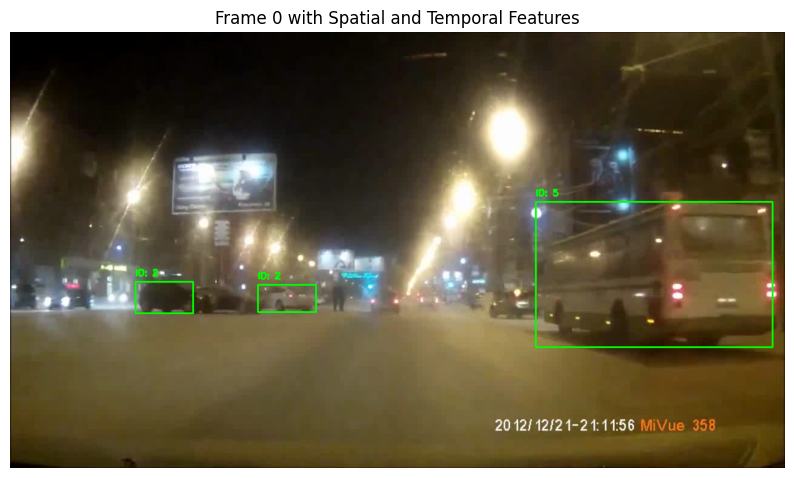

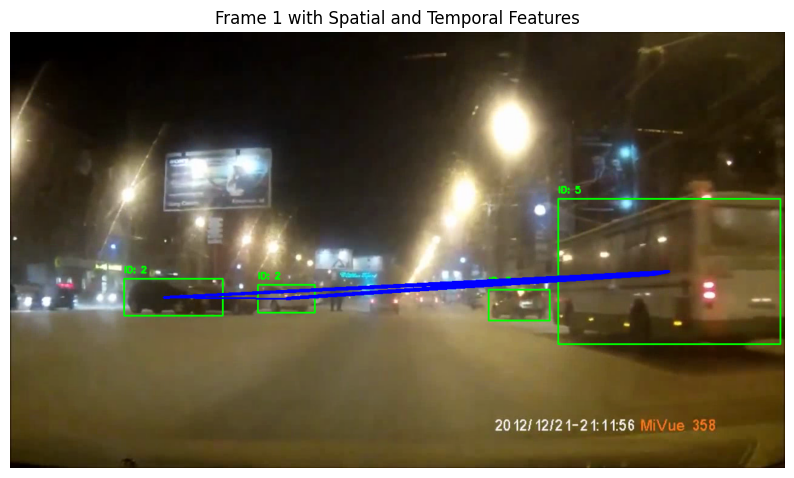

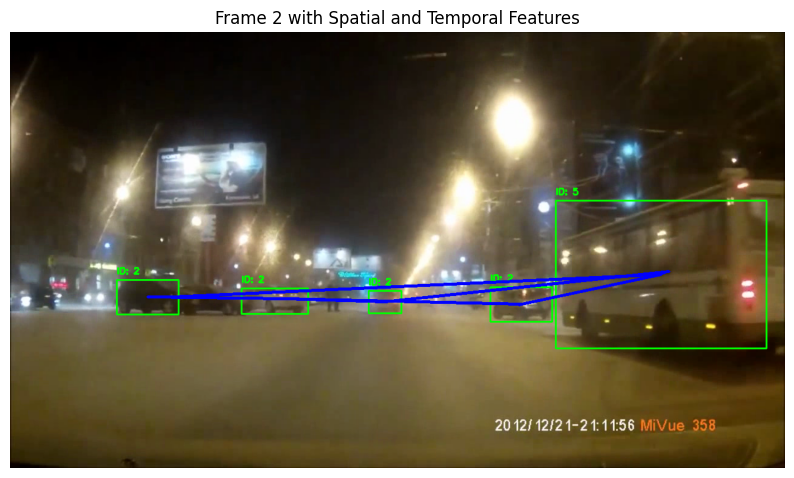

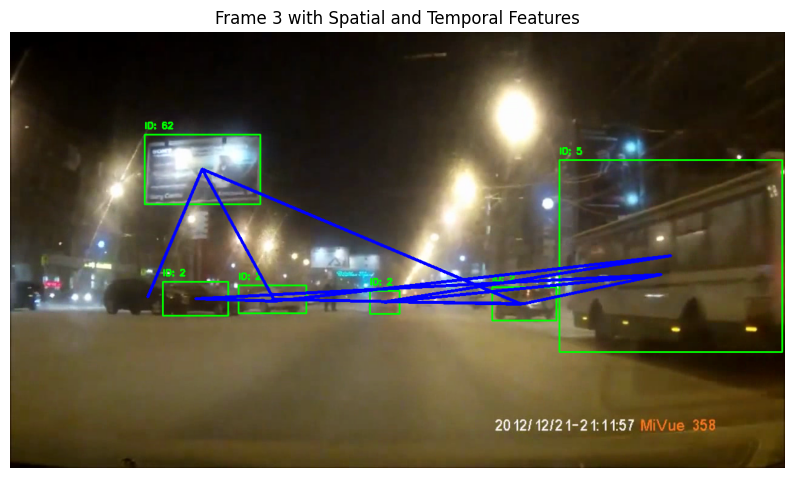

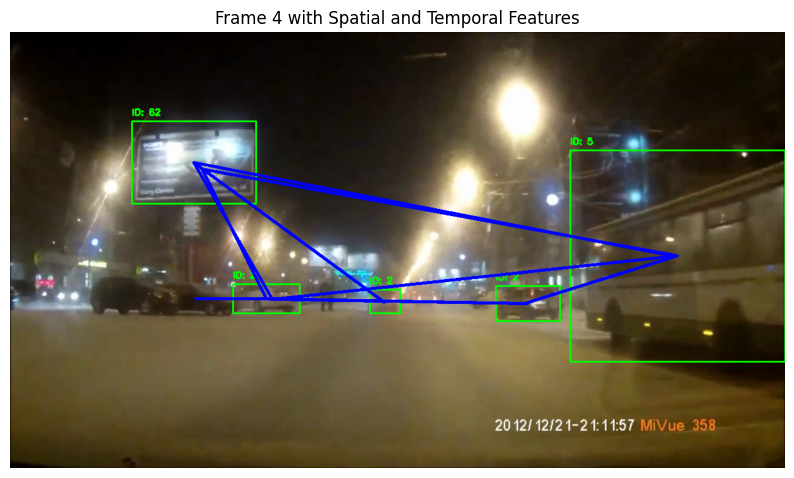

...

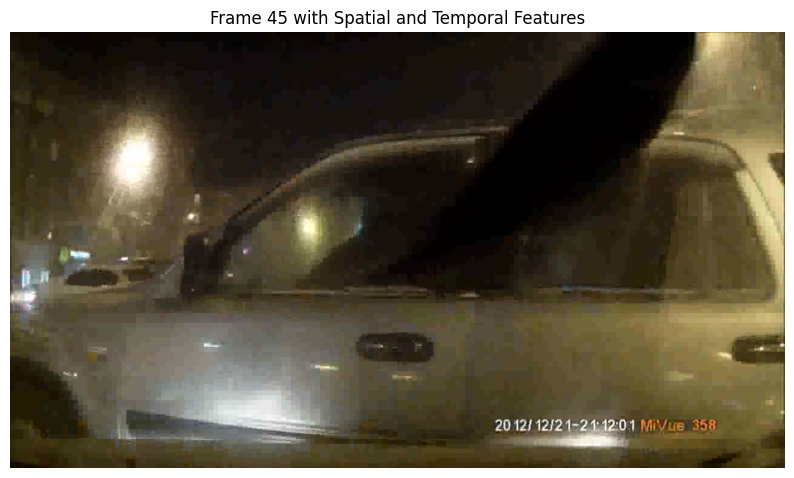

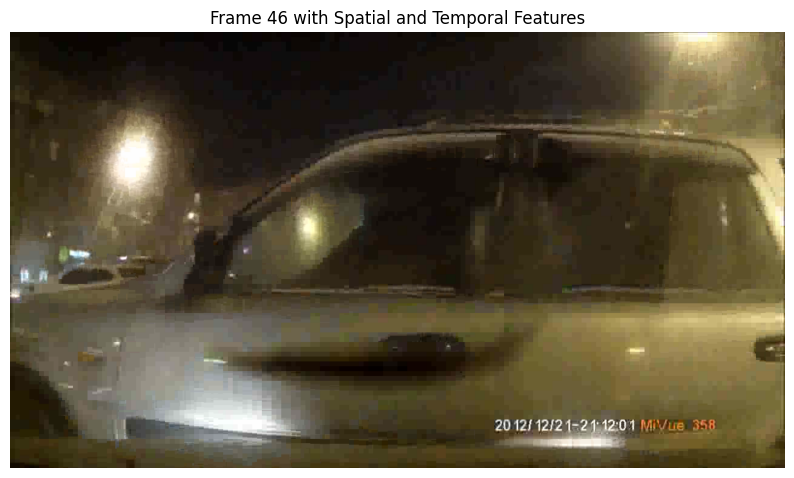

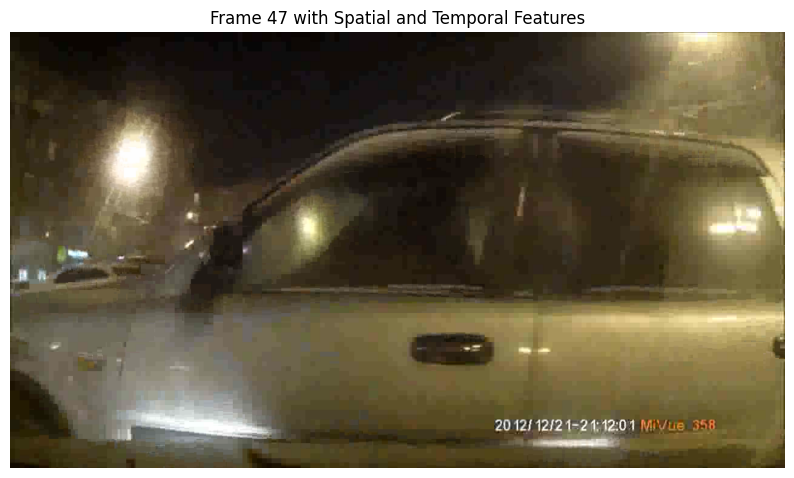

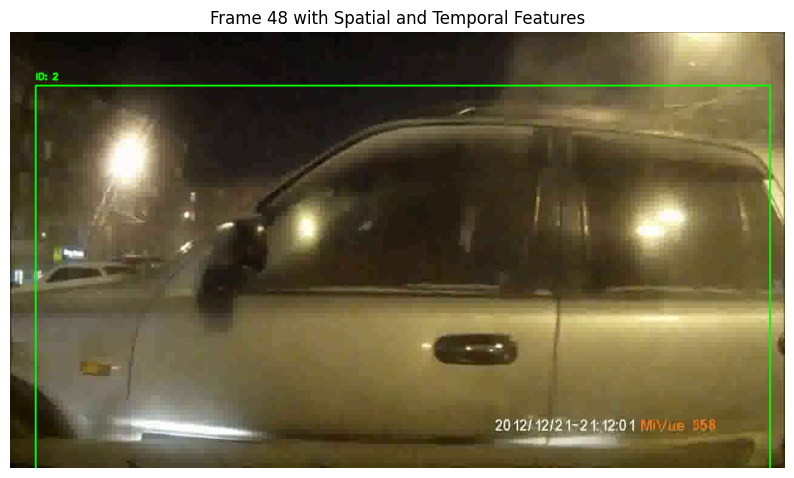

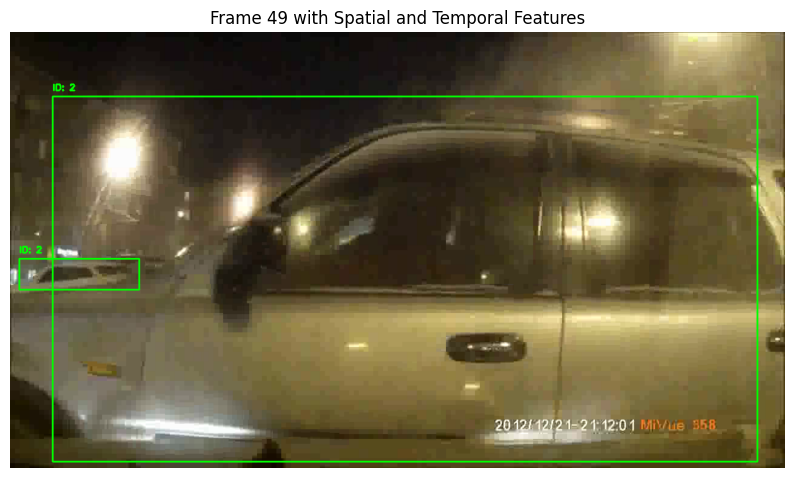

In [34]:
visualize_spatial_temporal_features('/Users/punsisikiridana/Documents/University_Education/MSc/SEMESTER_2/IN24_S2_CS5801_Advanced_AI/Project/GRAPH/Graph-Graph/data_preparation/CCD2/000028.mp4',yolo_model, classes, 'output_directory')

In [ ]:
import cv2
import numpy as np
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
from sklearn.metrics.pairwise import cosine_similarity
import random
# Define the GCN layer
""" class GCNLayer(nn.Module):
    def __init__(self, in_features, out_features):
        super(GCNLayer, self).__init__()
        self.fc = nn.Linear(in_features, out_features)

    def forward(self, x, adj):
        h = torch.matmul(adj, x)
        h = self.fc(h)
        return F.relu(h)

# Define the GCN model
class GCNModel(nn.Module):
    def __init__(self, in_features, hidden_features, out_features):
        super(GCNModel, self).__init__()
        self.gcn1 = GCNLayer(in_features, hidden_features)
        self.gcn2 = GCNLayer(hidden_features, out_features)

    def forward(self, x, adj):
        # Ensure dimensions align by trimming or padding the feature tensor
        min_dim = min(x.shape[1], adj.shape[1])
        x = x[:, :min_dim, :]
        adj = adj[:, :min_dim, :min_dim]

        x = self.gcn1(x, adj)
        x = self.gcn2(x, adj)
        return x
"""
# Video processing function with GCN integration
def process_video(video_path, yolo_model, classes, output_dir, accident=False, target_fps=20):
    cap = cv2.VideoCapture(video_path)
    frame_features = []
    box_features_list = []
    detections = []
    labels = []
    frame_ids = []
    spatial_adj_matrices = []
    temporal_adj_matrices = []

    frame_count = 0
    saved_frame_indices = [0, 10, 20, 30, 40]  # Indices of frames to save with bounding boxes

    original_fps = cap.get(cv2.CAP_PROP_FPS)
    frame_interval = int(original_fps / target_fps)

    previous_frame_boxes = []
    previous_frame_features = []

    while cap.isOpened() and frame_count < 50:
        ret, frame = cap.read()
        if not ret:
            break

        if frame_count % frame_interval == 0:
            # Extract frame-level features (using a CNN, here we just flatten the frame as a placeholder)
            frame_feature = cv2.resize(frame, (224, 224)).flatten()[:4096]  # Resize to ensure it fits 4096 elements

            frame_features.append(frame_feature)

            # Detect objects
            boxes = detect_objects(yolo_model, classes, frame)
            if len(boxes) > 19:
                boxes = boxes[:19]  # Ensure only 19 boxes are considered

            # Create box-level features (using the same placeholder approach for now)
            box_features = []
            for box in boxes:
                x1, y1, x2, y2, _, class_id = box
                box_frame = frame[y1:y2, x1:x2]
                if box_frame.size > 0:
                    box_feature = cv2.resize(box_frame, (64, 64)).flatten()[:4096]
                    box_features.append(box_feature)
                else:
                    box_features.append(np.zeros(4096))  # In case of invalid box

            while len(box_features) < 19:
                box_features.append(np.zeros(4096))  # Pad with zero features if less than 19 boxes

            box_features_list.append(box_features)
            # Convert boxes to a fixed size array
            while len(boxes) < 19:
                boxes.append([0, 0, 0, 0, 0.0, -1])  # Pad with default values if less than 19 boxes
            detections.append(np.array(boxes))

            # Create spatial adjacency matrix
            spatial_adj_matrix = np.zeros((len(boxes), len(boxes)))
            for i in range(len(boxes)):
                for j in range(len(boxes)):
                    if i != j:
                        ci = ((boxes[i][0] + boxes[i][2]) / 2, (boxes[i][1] + boxes[i][3]) / 2)
                        cj = ((boxes[j][0] + boxes[j][2]) / 2, (boxes[j][1] + boxes[j][3]) / 2)
                        spatial_adj_matrix[i, j] = np.exp(-np.linalg.norm(np.array(ci) - np.array(cj)))
            spatial_adj_matrices.append(spatial_adj_matrix)

            # Create temporal adjacency matrix
            if len(previous_frame_boxes) > 0:
                temporal_adj_matrix = np.zeros((len(boxes), len(previous_frame_boxes)))
                for i in range(len(boxes)):
                    for j in range(len(previous_frame_boxes)):
                        if classes[int(boxes[i][5])] == classes[int(previous_frame_boxes[j][5])]:
                            temporal_adj_matrix[i, j] = cosine_similarity(
                                [box_features[i]], [previous_frame_features[j]]
                            )[0, 0]
            else:
                temporal_adj_matrix = np.zeros((len(boxes), 19))  # Use a default zero matrix if no previous frame

            temporal_adj_matrices.append(temporal_adj_matrix)

            # Save previous frame boxes and features
            previous_frame_boxes = boxes
            previous_frame_features = box_features

            # Save frames with bounding boxes
            if len(frame_features) - 1 in saved_frame_indices:
                for box in boxes:
                    x1, y1, x2, y2, confidence, class_id = box
                    label = f"{classes[int(class_id)]}: {confidence:.2f}"
                    cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)
                    cv2.putText(frame, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)
                rnum = random.randint(0,999999999999999)
                output_frame_path = os.path.join(output_dir, f"frame_{len(frame_features) - 1}{str(rnum)}.jpg")
                cv2.imwrite(output_frame_path, frame)

            # Assign a label (placeholder, replace with actual logic)
            if accident:
                label = [0, 1]
            else:
                label = [1, 0]

            # Collect frame IDs (placeholder, replace with actual video name logic)
            frame_id = video_path.split('/')[-1].split('.')[0].strip()
            #frame_ids.append(f'frame_{len(frame_features) - 1}')  # Replace with actual frame ID or video ID logic
            

        frame_count += 1

    cap.release()

    # Ensure we have exactly 50 frames
    while len(frame_features) < 100:
        frame_features.append(np.zeros(4096))
        detections.append(np.array([[0, 0, 0, 0, 0.0, -1]] * 19))
        box_features_list.append([np.zeros(4096)] * 19)
        spatial_adj_matrices.append(np.zeros((19, 19)))
        temporal_adj_matrices.append(np.zeros((19, 19)))

    # Convert lists to numpy arrays
    frame_features = np.array(frame_features).reshape((100, 1, 4096))
    box_features = np.array(box_features_list).reshape((100, 19, 4096))
    detections = np.array(detections, dtype='float16').reshape((100, 19, 6))
    label = np.array(label, dtype='float16')
    frame_ids = np.array(frame_ids, dtype='<U11')
    spatial_adj_matrices = np.array(spatial_adj_matrices).reshape((100, 19, 19))
    temporal_adj_matrices = np.array(temporal_adj_matrices).reshape((100, 19, 19))

    # Combine frame-level and box-level features
    combined_features = np.concatenate((frame_features, box_features), axis=1)

    # Convert combined features and adjacency matrices to tensors
    #combined_features_tensor = torch.tensor(combined_features, dtype=torch.float32)
    #spatial_adj_matrices_tensor = torch.tensor(spatial_adj_matrices, dtype=torch.float32)
    #temporal_adj_matrices_tensor = torch.tensor(temporal_adj_matrices, dtype=torch.float32)

    # Define the GCN model
    #gcn_model = GCNModel(in_features=combined_features_tensor.shape[-1], hidden_features=64, out_features=2048)

    # Apply the GCN on spatial and temporal graphs separately
    #spatial_gcn_output = gcn_model(combined_features_tensor, spatial_adj_matrices_tensor)
    #temporal_gcn_output = gcn_model(combined_features_tensor, temporal_adj_matrices_tensor)

    # Combine the outputs
    #final_output = torch.cat((spatial_gcn_output, temporal_gcn_output), dim=-1)
    # Save to .npz file
    # Convert to NumPy array and change data type to float16
    final_output = combined_features.astype(np.float16)
    np.savez('npz_output/{}.npz'.format(frame_id), data=final_output, det=detections, labels=label, ID=frame_id)
    print("NPZ file successfully created.")
    visualize_spatial_temporal_features(spatial_adj_matrices, temporal_adj_matrices, frame_features, box_features_list)
    return final_output, detections, label, frame_id

New Code

In [ ]:
import cv2
import numpy as np
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
from sklearn.metrics.pairwise import cosine_similarity
import random
from gensim.models import KeyedVectors

# Load pre-trained word embeddings (GloVe)
glove_model = KeyedVectors.load_word2vec_format("glove.6B.300d.txt", binary=False, no_header=True)

# Define the GCN layer
class GCNLayer(nn.Module):
    def __init__(self, in_features, out_features):
        super(GCNLayer, self).__init__()
        self.fc = nn.Linear(in_features, out_features)

    def forward(self, x, adj):
        h = torch.matmul(adj, x)
        h = self.fc(h)
        return F.relu(h)

# Define the GCN model
class GCNModel(nn.Module):
    def __init__(self, in_features, hidden_features, out_features):
        super(GCNModel, self).__init__()
        self.gcn1 = GCNLayer(in_features, hidden_features)
        self.gcn2 = GCNLayer(hidden_features, out_features)

    def forward(self, x, adj):
        # Ensure dimensions align by trimming or padding the feature tensor
        min_dim = min(x.shape[1], adj.shape[1])
        x = x[:, :min_dim, :]
        adj = adj[:, :min_dim, :min_dim]

        x = self.gcn1(x, adj)
        x = self.gcn2(x, adj)
        return x

# Video processing function with GCN integration
def process_video(video_path, yolo_model, classes, output_dir, accident=False, target_fps=20):
    cap = cv2.VideoCapture(video_path)
    box_features_list = []
    detections = []
    labels = []
    frame_ids = []
    spatial_adj_matrices = []
    temporal_adj_matrices = []

    frame_count = 0
    saved_frame_indices = [0, 10, 20, 30, 40]  # Indices of frames to save with bounding boxes

    original_fps = cap.get(cv2.CAP_PROP_FPS)
    frame_interval = int(original_fps / target_fps)

    previous_frame_boxes = []
    previous_frame_features = []

    while cap.isOpened() and frame_count < 50:
        ret, frame = cap.read()
        if not ret:
            break

        if frame_count % frame_interval == 0:
            # Extract frame-level feature (e.g., mean pixel intensity or a dummy feature)
            frame_mean_intensity = np.mean(frame).reshape(1)  # Example: Mean intensity as a single feature
            frame_feature = np.concatenate((frame_mean_intensity, np.zeros(301)))  # Make it 302-dimensional
            
            # Detect objects
            boxes = detect_objects(yolo_model, classes, frame)
            if len(boxes) > 19:
                boxes = boxes[:19]  # Ensure only 19 boxes are considered

            # Create box-level features (using bounding box coordinates and label embeddings)
            box_features = []
            for box in boxes:
                x1, y1, x2, y2, _, class_id = box
                label = classes[int(class_id)]
                label_embedding = glove_model.get_vector(label) if label in glove_model else np.zeros(300)
                box_center = np.array([(x1 + x2) / 2, (y1 + y2) / 2])  # Using box center as feature
                box_feature = np.concatenate((box_center, label_embedding))
                box_features.append(box_feature)

            while len(box_features) < 19:
                box_features.append(np.zeros(302))  # Pad with zero features if less than 19 boxes

            # Append the frame-level feature as an additional node to the graph
            box_features.append(frame_feature)  # Add frame-level feature as the 20th node
            box_features_list.append(box_features)
            
            # Convert boxes to a fixed size array
            while len(boxes) < 19:
                boxes.append([0, 0, 0, 0, 0.0, -1])  # Pad with default values if less than 19 boxes
            detections.append(np.array(boxes))

            # Create spatial adjacency matrix
            spatial_adj_matrix = np.zeros((len(box_features), len(box_features)))  # Now size is 20x20
            for i in range(len(box_features) - 1):  # Exclude the last node (frame-level feature) from adjacency
                for j in range(len(box_features) - 1):
                    if i != j:
                        ci = ((boxes[i][0] + boxes[i][2]) / 2, (boxes[i][1] + boxes[i][3]) / 2)
                        cj = ((boxes[j][0] + boxes[j][2]) / 2, (boxes[j][1] + boxes[j][3]) / 2)
                        spatial_adj_matrix[i, j] = np.exp(-np.linalg.norm(np.array(ci) - np.array(cj)))
            spatial_adj_matrices.append(spatial_adj_matrix)

            # Create temporal adjacency matrix
            if len(previous_frame_boxes) > 0:
                temporal_adj_matrix = np.zeros((len(box_features), len(previous_frame_boxes)))
                for i in range(len(box_features) - 1):  # Exclude the last node (frame-level feature) from adjacency
                    for j in range(len(previous_frame_boxes)):
                        if classes[int(boxes[i][5])] == classes[int(previous_frame_boxes[j][5])]:
                            temporal_adj_matrix[i, j] = cosine_similarity(
                                [box_features[i]], [previous_frame_features[j]]
                            )[0, 0]
            else:
                temporal_adj_matrix = np.zeros((len(box_features), 19))  # Use a default zero matrix if no previous frame

            temporal_adj_matrices.append(temporal_adj_matrix)

            # Save previous frame boxes and features
            previous_frame_boxes = boxes
            previous_frame_features = box_features

            # Save frames with bounding boxes
            if len(box_features_list) - 1 in saved_frame_indices:
                for box in boxes:
                    x1, y1, x2, y2, confidence, class_id = box
                    label = f"{classes[int(class_id)]}: {confidence:.2f}"
                    cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)
                    cv2.putText(frame, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)
                rnum = random.randint(0, 999999999999999)
                output_frame_path = os.path.join(output_dir, f"frame_{len(box_features_list) - 1}{str(rnum)}.jpg")
                cv2.imwrite(output_frame_path, frame)

            # Assign a label (placeholder, replace with actual logic)
            if accident:
                label = [0, 1]
            else:
                label = [1, 0]

            # Collect frame IDs (placeholder, replace with actual video name logic)
            frame_id = video_path.split('/')[-1].split('.')[0].strip()
            frame_ids.append(frame_id)

        frame_count += 1

    cap.release()

    # Ensure we have exactly 100 frames
    while len(box_features_list) < 100:
        box_features_list.append([np.zeros(302)] * 20)
        detections.append(np.array([[0, 0, 0, 0, 0.0, -1]] * 19))
        spatial_adj_matrices.append(np.zeros((20, 20)))
        temporal_adj_matrices.append(np.zeros((20, 19)))

    # Convert lists to numpy arrays
    box_features = np.array(box_features_list).reshape((100, 20, 302))
    detections = np.array(detections, dtype='float16').reshape((100, 19, 6))
    label = np.array(label, dtype='float16')
    frame_ids = np.array(frame_ids, dtype='<U11')
    spatial_adj_matrices = np.array(spatial_adj_matrices).reshape((100, 20, 20))
    temporal_adj_matrices = np.array(temporal_adj_matrices).reshape((100, 20, 19))

    # Convert features and adjacency matrices to tensors
    box_features_tensor = torch.tensor(box_features, dtype=torch.float32)
    spatial_adj_matrices_tensor = torch.tensor(spatial_adj_matrices, dtype=torch.float32)
    temporal_adj_matrices_tensor = torch.tensor(temporal_adj_matrices, dtype=torch.float32)

    # Define the GCN model
    gcn_model = GCNModel(in_features=box_features_tensor.shape[-1], hidden_features=64, out_features=2048)

    # Apply the GCN on spatial and temporal graphs separately
    spatial_gcn_output = gcn_model(box_features_tensor, spatial_adj_matrices_tensor)
    temporal_gcn_output = gcn_model(box_features_tensor, temporal_adj_matrices_tensor)

    # Combine the outputs
    final_output = torch.cat((spatial_gcn_output, temporal_gcn_output), dim=-1)
    # Convert to NumPy array and change data type to float16
    final_output = final_output.detach().numpy().astype(np.float16)
    np.savez(os.path.join(output_dir, f'{frame_id}.npz'), data=final_output, det=detections, labels=label, ID=frame_id)
    print("NPZ file successfully created.")

    return final_output, detections, label, frame_id

In [ ]:
import cv2
import numpy as np
import os
import torch
import torch.nn as nn
import torch.nn.functional as F

# Define the GCN layer with Batch Normalization (BN)
class GCNLayer(nn.Module):
    def __init__(self, in_features, out_features):
        super(GCNLayer, self).__init__()
        self.fc = nn.Linear(in_features, out_features)
        self.bn = nn.BatchNorm1d(out_features)

    def forward(self, x, adj):
        h = torch.matmul(adj, x)
        h = self.fc(h)
        h = self.bn(h)
        return F.relu(h)

# Define the Fully-Connected Layer with Batch Normalization (BN)
class FC_BN(nn.Module):
    def __init__(self, in_features, out_features):
        super(FC_BN, self).__init__()
        self.fc = nn.Linear(in_features, out_features)
        self.bn = nn.BatchNorm1d(out_features)

    def forward(self, x):
        x = self.fc(x)
        x = self.bn(x)
        return F.relu(x)

# Define the full model including FC layers and GCN layers for both spatial and temporal adjacency matrices
class FullModel(nn.Module):
    def __init__(self):
        super(FullModel, self).__init__()
        self.fc1 = FC_BN(4096, 512)  # First branch
        self.fc2 = FC_BN(4096, 128)  # Second branch
        self.gc1_spatial = GCNLayer(512, 128)  # GCN for spatial adjacency (512-dimension branch)
        self.gc2_spatial = GCNLayer(128, 128)  # GCN for spatial adjacency (128-dimension branch)
        self.gc1_temporal = GCNLayer(512, 128)  # GCN for temporal adjacency (512-dimension branch)
        self.gc2_temporal = GCNLayer(128, 128)  # GCN for temporal adjacency (128-dimension branch)
        self.instance_norm1 = nn.InstanceNorm1d(128)
        self.instance_norm2 = nn.InstanceNorm1d(128)

    def forward(self, x, spatial_adj, temporal_adj):
        # Spatial GCN Branch
        x1 = self.fc1(x)  # 512-dimension branch
        x1_spatial = self.gc1_spatial(x1, spatial_adj)
        x1_spatial = self.gc2_spatial(x1_spatial, spatial_adj)
        x1_spatial = self.instance_norm1(x1_spatial)

        # Temporal GCN Branch
        x2 = self.fc2(x)  # 128-dimension branch
        x2_temporal = self.gc1_temporal(x2, temporal_adj)
        x2_temporal = self.gc2_temporal(x2_temporal, temporal_adj)
        x2_temporal = self.instance_norm2(x2_temporal)

        # Concatenate the outputs from both spatial and temporal branches
        x_combined = torch.cat([x1_spatial, x2_temporal], dim=-1)  # Concatenate along the feature dimension
        return x_combined

# Video processing function with the full model including temporal GCN
def process_video(video_path, yolo_model, classes, output_dir, accident=False, target_fps=20):
    cap = cv2.VideoCapture(video_path)
    frame_features = []
    box_features_list = []
    detections = []
    labels = []
    frame_ids = []
    spatial_adj_matrices = []
    temporal_adj_matrices = []

    frame_count = 0
    saved_frame_indices = [0, 10, 20, 30, 40]  # Indices of frames to save with bounding boxes

    original_fps = cap.get(cv2.CAP_PROP_FPS)
    frame_interval = int(original_fps / target_fps)

    previous_frame_boxes = []
    previous_frame_features = []

    model = FullModel()

    while cap.isOpened() and frame_count < 50:
        ret, frame = cap.read()
        if not ret:
            break

        if frame_count % frame_interval == 0:
            # Extract frame-level features (flattened frame as a placeholder)
            frame_feature = cv2.resize(frame, (224, 224)).flatten()[:4096]
            frame_features.append(frame_feature)

            # Detect objects
            boxes = detect_objects(yolo_model, classes, frame)
            if len(boxes) > 19:
                boxes = boxes[:19]  # Ensure only 19 boxes are considered

            # Create box-level features
            box_features = []
            for box in boxes:
                x1, y1, x2, y2, _, class_id = box
                box_frame = frame[y1:y2, x1:x2]
                if box_frame.size > 0:
                    box_feature = cv2.resize(box_frame, (64, 64)).flatten()[:4096]
                    box_features.append(box_feature)
                else:
                    box_features.append(np.zeros(4096))  # In case of invalid box

            while len(box_features) < 19:
                box_features.append(np.zeros(4096))  # Pad with zero features if less than 19 boxes

            box_features_list.append(box_features)
            detections.append(np.array(boxes))

            # Create spatial adjacency matrix
            spatial_adj_matrix = np.zeros((19, 19))  # Ensure the matrix is always (19, 19)
            for i in range(len(boxes)):
                for j in range(len(boxes)):
                    if i != j:
                        ci = ((boxes[i][0] + boxes[i][2]) / 2, (boxes[i][1] + boxes[i][3]) / 2)
                        cj = ((boxes[j][0] + boxes[j][2]) / 2, (boxes[j][1] + boxes[j][3]) / 2)
                        spatial_adj_matrix[i, j] = np.exp(-np.linalg.norm(np.array(ci) - np.array(cj)))
            spatial_adj_matrices.append(spatial_adj_matrix)

            # Create temporal adjacency matrix
            temporal_adj_matrix = np.zeros((19, 19))  # Ensure the matrix is always (19, 19)
            if len(previous_frame_boxes) > 0:
                for i in range(len(boxes)):
                    for j in range(len(previous_frame_boxes)):
                        if classes[int(boxes[i][5])] == classes[int(previous_frame_boxes[j][5])]:
                            temporal_adj_matrix[i, j] = cosine_similarity(
                                [box_features[i]], [previous_frame_features[j]]
                            )[0, 0]

            temporal_adj_matrices.append(temporal_adj_matrix)

            # Save previous frame boxes and features
            previous_frame_boxes = boxes
            previous_frame_features = box_features

            # Save frames with bounding boxes
            if len(frame_features) - 1 in saved_frame_indices:
                for box in boxes:
                    x1, y1, x2, y2, confidence, class_id = box
                    label = f"{classes[int(class_id)]}: {confidence:.2f}"
                    cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)
                    cv2.putText(frame, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)
                rnum = random.randint(0,999999999999999)
                output_frame_path = os.path.join(output_dir, f"frame_{len(frame_features) - 1}{str(rnum)}.jpg")
                cv2.imwrite(output_frame_path, frame)

            # Assign a label (placeholder, replace with actual logic)
            if accident:
                label = [0, 1]
            else:
                label = [1, 0]

            frame_id = video_path.split('/')[-1].split('.')[0].strip()

        frame_count += 1

    cap.release()

    # Ensure we have exactly 100 frames
    while len(frame_features) < 100:
        frame_features.append(np.zeros(4096))
        detections.append(np.array([[0, 0, 0, 0, 0.0, -1]] * 19))
        box_features_list.append([np.zeros(4096)] * 19)
        spatial_adj_matrices.append(np.zeros((19, 19)))
        temporal_adj_matrices.append(np.zeros((19, 19)))

    # Convert lists to numpy arrays with proper dtype
    spatial_adj_matrices_array = np.stack(spatial_adj_matrices, axis=0).astype(np.float32)
    temporal_adj_matrices_array = np.stack(temporal_adj_matrices, axis=0).astype(np.float32)

    spatial_adj_matrices_tensor = torch.tensor(spatial_adj_matrices_array)
    temporal_adj_matrices_tensor = torch.tensor(temporal_adj_matrices_array)

    frame_features = np.array(frame_features).reshape((100, 1, 4096))
    box_features = np.array(box_features_list).reshape((100, 19, 4096))

    # Combine frame-level and box-level features
    combined_features = np.concatenate((frame_features, box_features), axis=1)  # Shape will be (100, 20, 4096)
    combined_features_tensor = torch.tensor(combined_features, dtype=torch.float32)

    # Apply the model using both spatial and temporal adjacency matrices
    final_output = model(combined_features_tensor, spatial_adj_matrices_tensor, temporal_adj_matrices_tensor)

    # Save to .npz file
    final_output = final_output.detach().numpy().astype(np.float16)
    np.savez(os.path.join(output_dir, f'{frame_id}.npz'), data=final_output, det=detections, labels=label, ID=frame_id)
    print("NPZ file successfully created.")
    return final_output, detections, label, frame_id

In [ ]:
# Directory to save frames with bounding boxes
output_dir = 'output_frames_2'
os.makedirs(output_dir, exist_ok=True)

NPZ file successfully created.


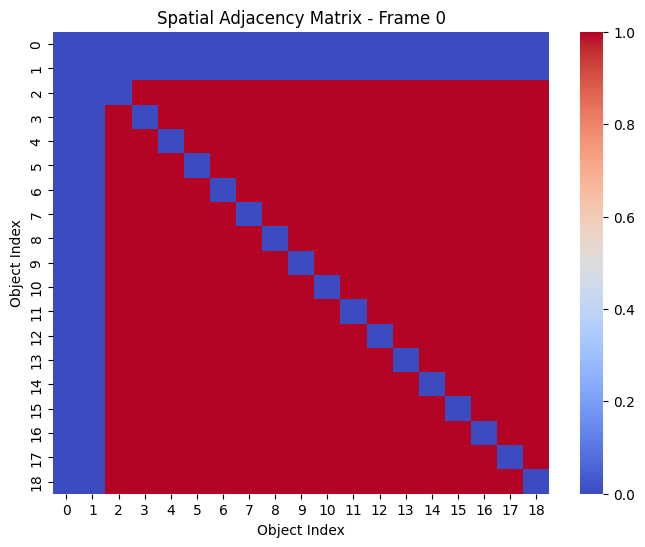

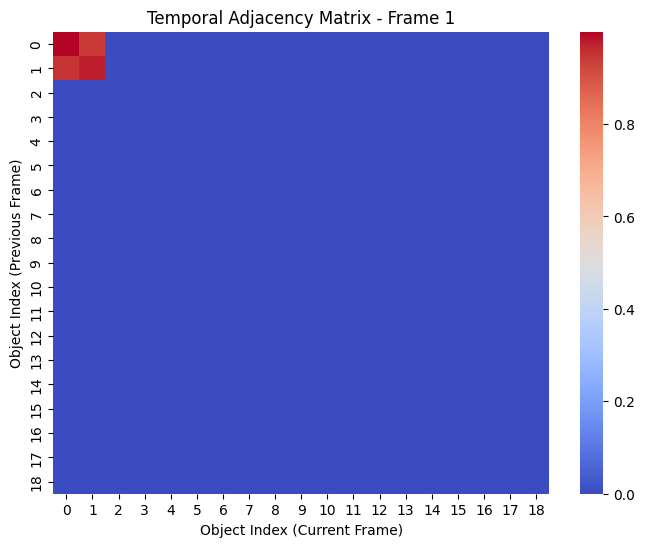

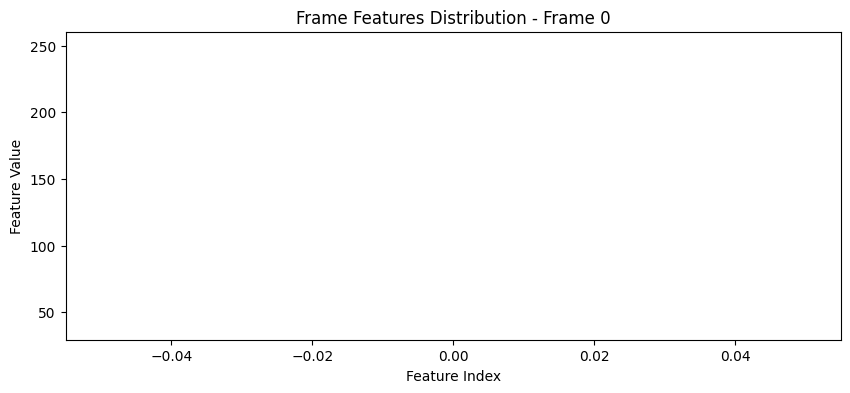

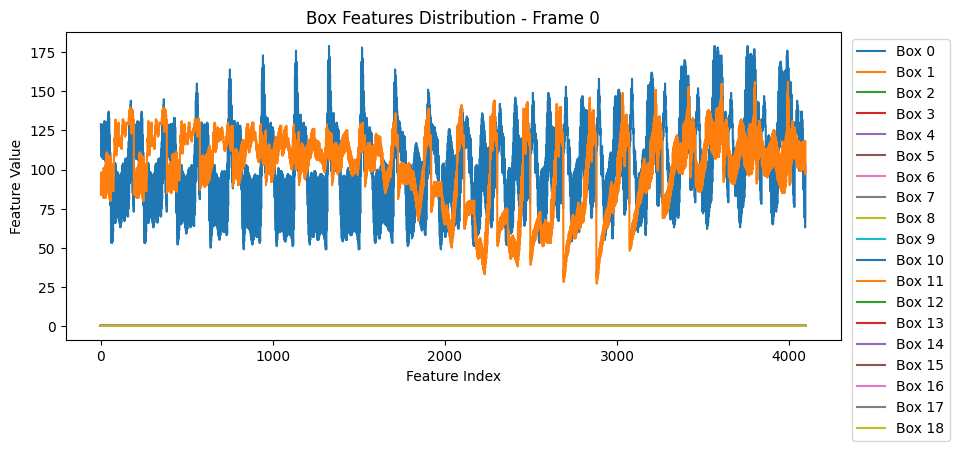

NPZ file successfully created.


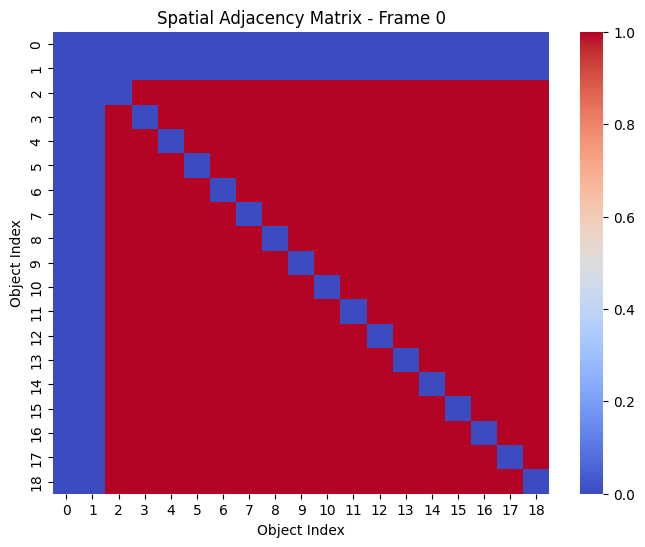

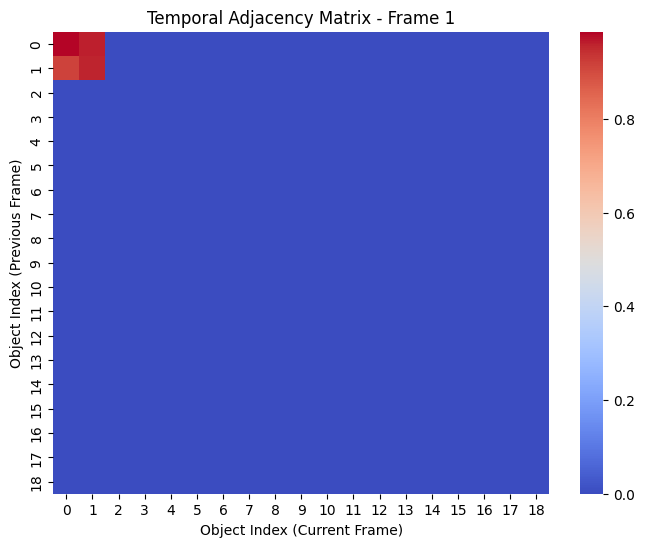

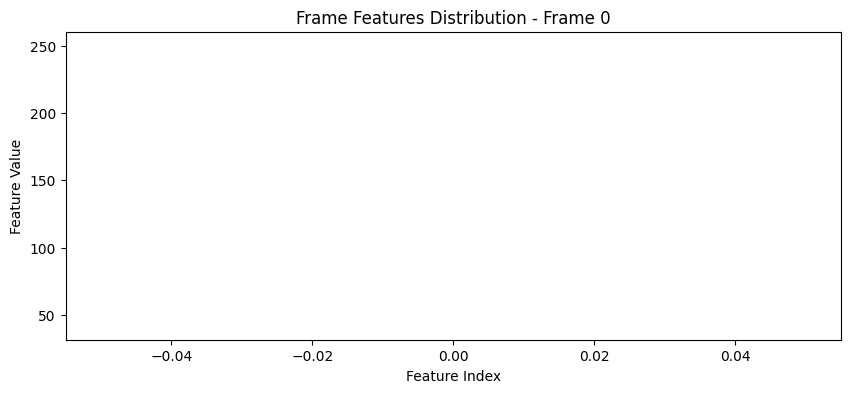

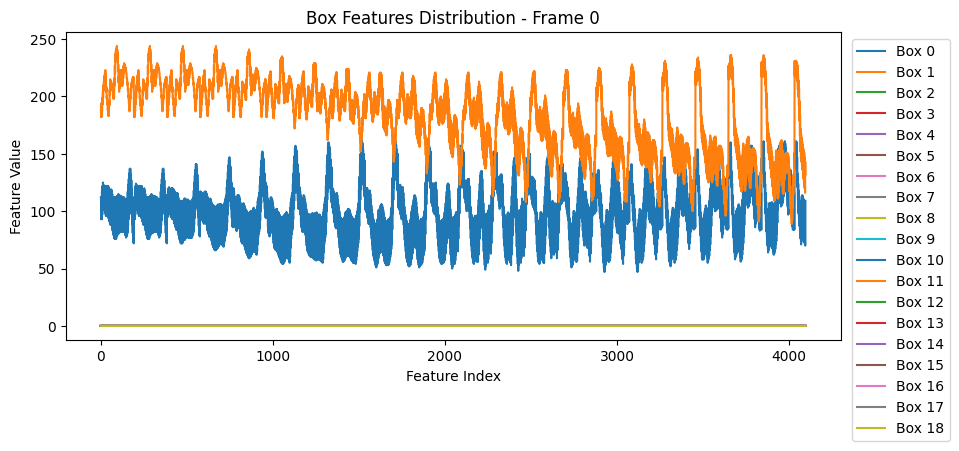

KeyboardInterrupt: 

In [ ]:
import os

# Process the video
folder_path = '/Users/punsisikiridana/Documents/University_Education/MSc/SEMESTER_2/IN24_S2_CS5801_Advanced_AI/Project/GRAPH/Graph-Graph/data_preparation/input_clips/negative'
output_dir = "npz_output"
accident=False
for file_name in os.listdir(folder_path):
    if file_name.endswith('.mp4'):
        video_path = os.path.join(folder_path, file_name)
        data, det, labels, ID = process_video(video_path, yolo_model, classes, output_dir, accident, target_fps=20)
        # Do something with the data, det, labels, and ID variables

In [ ]:
import os
import cv2
import numpy as np

def get_video_dimensions(video_path):
    # Open the video file
    cap = cv2.VideoCapture(video_path)
    
    if not cap.isOpened():
        print(f"Error: Could not open video {video_path}.")
        return None
    
    # Get the width and height of the video
    width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    
    # Release the video capture object
    cap.release()
    
    return width, height

def save_video_dimensions(folder_path, output_folder):
    # List all files in the folder
    files = os.listdir(folder_path)
    
    # Filter out only .mp4 files
    mp4_files = [file for file in files if file.endswith('.mp4')]
    
    # Ensure the output folder exists
    os.makedirs(output_folder, exist_ok=True)
    
    # Get dimensions for each video file and save as .npy
    for file_name in mp4_files:
        video_path = os.path.join(folder_path, file_name)
        dims = get_video_dimensions(video_path)
        if dims:
            # Create an array with 100 [width, height] entries
            repeated_dims = np.tile(dims, (100, 1))
            # Save the NumPy array as a .npy file
            output_path = os.path.join(output_folder, f"{os.path.splitext(file_name)[0]}.npy")
            np.save(output_path, repeated_dims)
            print(len(repeated_dims))
            print(repeated_dims)
            print(f"Dimensions array for {file_name} saved to {output_path}")

# Example usage
folder_path = '/Users/punsisikiridana/Documents/University_Education/MSc/SEMESTER_2/IN24_S2_CS5801_Advanced_AI/Project/GRAPH/Graph-Graph/data_preparation/input_clips/positive'
output_folder = '/Users/punsisikiridana/Documents/University_Education/MSc/SEMESTER_2/IN24_S2_CS5801_Advanced_AI/Project/GRAPH/Graph-Graph/data_preparation/video_dimensions'
save_video_dimensions(folder_path, output_folder)

100
[[ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1280]
 [ 720 1

In [ ]:
# Print the sizes of the arrays
print("Size of data:", data.shape)
print(data[0])
print("Size of det:", det.shape)
print("Size of labels:", labels.shape)
print("Size of ID:", ID.shape)

Size of data: torch.Size([100, 19, 4096])
tensor([[5.5753e-02, 8.3713e-02, 0.0000e+00,  ..., 0.0000e+00, 1.2113e-01,
         3.1419e-03],
        [5.5753e-02, 8.3713e-02, 0.0000e+00,  ..., 0.0000e+00, 1.2113e-01,
         3.1419e-03],
        [5.5753e-02, 8.3713e-02, 0.0000e+00,  ..., 0.0000e+00, 1.2113e-01,
         3.1419e-03],
        ...,
        [4.9963e+01, 3.9268e+01, 1.9797e+02,  ..., 0.0000e+00, 1.2113e-01,
         3.1419e-03],
        [4.9963e+01, 3.9268e+01, 1.9797e+02,  ..., 0.0000e+00, 1.2113e-01,
         3.1419e-03],
        [4.9963e+01, 3.9268e+01, 1.9797e+02,  ..., 0.0000e+00, 1.2113e-01,
         3.1419e-03]], grad_fn=<SelectBackward0>)
Size of det: (100, 19, 6)
Size of labels: (2,)
Size of ID: (50,)


In [ ]:
import torch
import numpy as np

# Convert to NumPy array and change data type to float16
data = data.detach().numpy().astype(np.float16)

# Check the size and data type
print("Size of numpy_data:", data.shape)
print("Data type of numpy_data:", data.dtype)

Size of numpy_data: (100, 19, 4096)
Data type of numpy_data: float16


In [ ]:
# Save to .npz file
np.savez('video_1.npz', data=data, det=det, labels=labels, ID=ID)
print("NPZ file successfully created.")

NPZ file successfully created.


In [ ]:
def read_npz_file(npz_file_path):
    # Load the .npz file
    npzfile = np.load(npz_file_path)

    # Print the sizes of the available arrays
    for array_name in npzfile.files:
        array = npzfile[array_name]
        print(f"Size of {array_name}: {array.shape}")
        print(array[0])

# Path to the .npz file
npz_file_path = 'npz_output/clip_0016.npz'
#npz_file_path = '/Users/punsisikiridana/Documents/University_Education/MSc/SEMESTER_2/IN24_S2_CS5801_Advanced_AI/Project/GRAPH/Graph-Graph/data/dad/obj_feat/training/b001_000003.npz'
# Read and print sizes of arrays in the .npz file
read_npz_file(npz_file_path)

Size of data: (100, 20, 4096)
[[249. 251. 237. ... 251. 237. 249.]
 [ 43.  34.  47. ... 150. 145. 167.]
 [104. 134. 131. ... 211. 211. 203.]
 ...
 [  0.   0.   0. ...   0.   0.   0.]
 [  0.   0.   0. ...   0.   0.   0.]
 [  0.   0.   0. ...   0.   0.   0.]]
Size of det: (100, 19, 6)
[[346.     528.     585.     737.       0.995    2.    ]
 [532.     443.     557.     460.       0.8813   2.    ]
 [  0.       0.       0.       0.       0.      -1.    ]
 [  0.       0.       0.       0.       0.      -1.    ]
 [  0.       0.       0.       0.       0.      -1.    ]
 [  0.       0.       0.       0.       0.      -1.    ]
 [  0.       0.       0.       0.       0.      -1.    ]
 [  0.       0.       0.       0.       0.      -1.    ]
 [  0.       0.       0.       0.       0.      -1.    ]
 [  0.       0.       0.       0.       0.      -1.    ]
 [  0.       0.       0.       0.       0.      -1.    ]
 [  0.       0.       0.       0.       0.      -1.    ]
 [  0.       0.       0.       0

IndexError: too many indices for array: array is 0-dimensional, but 1 were indexed

Size of data: (50, 20, 4096)
Size of det: (50, 19, 6)
Size of labels: (50, 2)
Size of ID: (50,)

In [ ]:
#Code to read npy files in npz and display
import numpy as np

# Load the .npz file
npz_file = np.load('/Users/punsisikiridana/Documents/University_Education/MSc/SEMESTER_2/IN24_S2_CS5801_Advanced_AI/Project/GRAPH/Graph-Graph/data_preparation/npz_output/Positive/clip_0007.npz')

# Iterate through the items in the .npz file
for file_name in npz_file.files:
    print(f"Contents of {file_name}:")
    print(npz_file[file_name])

#npz_file_2 = np.load('/Users/punsisikiridana/Documents/University_Education/MSc/SEMESTER_2/IN24_S2_CS5801_Advanced_AI/Project/GRAPH/Graph-Graph/data/dad/obj_feat/training/b001_000007.npz')
#for file_name in npz_file_2.files:
#    try:
#        print(f"Contents of {file_name}:")
#        print(npz_file_2[file_name][0])
#    except:
#        continue

Contents of data:
[[[251. 253. 233. ... 251. 237. 249.]
  [137. 133. 136. ... 151. 146. 165.]
  [ 29.  89.  72. ...  71.  23. 176.]
  ...
  [  0.   0.   0. ...   0.   0.   0.]
  [  0.   0.   0. ...   0.   0.   0.]
  [  0.   0.   0. ...   0.   0.   0.]]

 [[252. 254. 235. ... 252. 238. 250.]
  [144. 136. 139. ... 145. 141. 167.]
  [ 33.  97.  81. ... 189. 139. 173.]
  ...
  [  0.   0.   0. ...   0.   0.   0.]
  [  0.   0.   0. ...   0.   0.   0.]
  [  0.   0.   0. ...   0.   0.   0.]]

 [[252. 254. 235. ... 252. 238. 250.]
  [142. 134. 137. ... 151. 146. 165.]
  [ 30.  87.  69. ... 130. 112.  91.]
  ...
  [  0.   0.   0. ...   0.   0.   0.]
  [  0.   0.   0. ...   0.   0.   0.]
  [  0.   0.   0. ...   0.   0.   0.]]

 ...

 [[  0.   0.   0. ...   0.   0.   0.]
  [  0.   0.   0. ...   0.   0.   0.]
  [  0.   0.   0. ...   0.   0.   0.]
  ...
  [  0.   0.   0. ...   0.   0.   0.]
  [  0.   0.   0. ...   0.   0.   0.]
  [  0.   0.   0. ...   0.   0.   0.]]

 [[  0.   0.   0. ...   0.   0. 

In [ ]:
import numpy as np

# Load the .npy file
file_path = '/Users/punsisikiridana/Documents/University_Education/MSc/SEMESTER_2/IN24_S2_CS5801_Advanced_AI/Project/GRAPH/Graph-Graph/data_preparation/output_data/det.npy'  # Replace with the actual file path
data = np.load(file_path)

# Print the content
print(data)

[[[ 6.29000000e+02  2.49000000e+02  6.81000000e+02  2.94000000e+02
    6.10710680e-01  2.00000000e+00]
  [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
    0.00000000e+00 -1.00000000e+00]
  [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
    0.00000000e+00 -1.00000000e+00]
  ...
  [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
    0.00000000e+00 -1.00000000e+00]
  [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
    0.00000000e+00 -1.00000000e+00]
  [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
    0.00000000e+00 -1.00000000e+00]]

 [[ 6.28000000e+02  2.47000000e+02  6.81000000e+02  2.94000000e+02
    6.97979450e-01  2.00000000e+00]
  [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
    0.00000000e+00 -1.00000000e+00]
  [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
    0.00000000e+00 -1.00000000e+00]
  ...
  [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000

I3D

In [ ]:
import torch
import torch.nn as nn
import torchvision.transforms as transforms
#from pytorch_i3d import InceptionI3d  # Assuming you've installed a PyTorch implementation of I3D
import numpy as np
import cv2


# Custom I3D model implementation (replace with actual implementation)
class InceptionI3d(nn.Module):
    def __init__(self, num_classes, in_channels=3):
        super(InceptionI3d, self).__init__()
        # Define the I3D model layers here
        pass

    def forward(self, x):
        # Define the forward pass here
        pass

# Load the I3D model
model = InceptionI3d(400, in_channels=3)  # 400 is for the Kinetics-400 dataset
model.load_state_dict(torch.load('rgb_imagenet.pt'))  # Load the pre-trained model weights
model.eval()

# Modify the model to output 4096-dim features instead of logits
class FeatureExtractor(nn.Module):
    def __init__(self, i3d):
        super(FeatureExtractor, self).__init__()
        self.i3d = nn.Sequential(*list(i3d.children())[:-1])  # Remove the classifier layer
        self.fc = nn.Linear(1024, 4096)  # Assuming the last feature dimension is 1024

    def forward(self, x):
        x = self.i3d(x)
        x = torch.flatten(x, start_dim=1)  # Flatten to (batch_size, 1024)
        x = self.fc(x)
        return x




# Load the I3D model
model = InceptionI3d(400, in_channels=3)  # 400 is for the Kinetics-400 dataset
model.load_state_dict(torch.load('rgb_imagenet.pt'))  # Load the pre-trained model weights
model.eval()

# Modify the model to output 4096-dim features instead of logits
class FeatureExtractor(nn.Module):
    def __init__(self, i3d):
        super(FeatureExtractor, self).__init__()
        self.i3d = nn.Sequential(*list(i3d.children())[:-1])  # Remove the classifier layer
        self.fc = nn.Linear(1024, 4096)  # Assuming the last feature dimension is 1024

    def forward(self, x):
        x = self.i3d(x)
        x = torch.flatten(x, start_dim=1)  # Flatten to (batch_size, 1024)
        x = self.fc(x)
        return x

feature_extractor = FeatureExtractor(model)

# Function to extract frames from a video
def extract_frames(video_path, num_frames=100):
    cap = cv2.VideoCapture(video_path)
    frame_count = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
    interval = frame_count // num_frames
    frames = []

    for i in range(num_frames):
        cap.set(cv2.CAP_PROP_POS_FRAMES, i * interval)
        ret, frame = cap.read()
        if ret:
            frame = cv2.resize(frame, (224, 224))
            frames.append(frame)
        else:
            frames.append(np.zeros((224, 224, 3)))  # Pad with black frames if fewer frames are available

    cap.release()
    frames = np.array(frames)
    return frames

# Function to extract global features using I3D
def extract_global_features(video_path, output_npy='global_features.npy'):
    # Extract frames
    frames = extract_frames(video_path, num_frames=100)

    # Preprocess the frames
    preprocess = transforms.Compose([
        transforms.ToTensor(),  # Convert to Tensor
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),  # Normalize
    ])

    frames = torch.stack([preprocess(frame) for frame in frames])  # Stack into a tensor
    frames = frames.unsqueeze(0)  # Add batch dimension, shape (1, 100, 3, 224, 224)

    # Pass through the I3D feature extractor
    with torch.no_grad():
        features = feature_extractor(frames)

    features = features.squeeze(0).numpy()  # Remove batch dimension, resulting shape (100, 4096)

    # Save to a .npy file
    np.save(output_npy, features)
    print(f"Features saved to {output_npy}")

# Example usage
video_path = 'example_video.mp4'
extract_global_features(video_path, output_npy='global_features.npy')

FileNotFoundError: [Errno 2] No such file or directory: 'rgb_imagenet.pt'

In [ ]:
import torch
import torch.nn as nn
from pytorchvideo.models.hub import i3d_r50  # Importing I3D from pytorchvideo    
class GlobalFeatureExtractor(torch.nn.Module):
    def __init__(self, i3d, feature_dim=2048):
        super(GlobalFeatureExtractor, self).__init__()
        self.i3d = i3d
        self.fc = torch.nn.Linear(1024, feature_dim)  # I3D typically outputs 1024-dim features
    
    def forward(self, x):
        features = self.i3d(x)  # Extract features
        # Verify the shape of the features tensor
        print(f"Features shape: {features.shape}")
        
        # Ensure features tensor has the correct number of dimensions
        if features.dim() == 5:  # Expected shape: (batch_size, channels, frames, height, width)
            reduced_features = self.fc(features.mean(dim=[2, 3, 4]))  # Reduce dimensions
        elif features.dim() == 4:  # Shape might be (batch_size, channels, frames, height/width)
            reduced_features = self.fc(features.mean(dim=[1, 2, 3]))
        else:
            raise ValueError(f"Unexpected tensor shape: {features.shape}")
        
        return reduced_features


# Load pretrained I3D model
i3d_model = i3d_r50(pretrained=True)  # I3D model with ResNet-50 backbone
global_feature_extractor = GlobalFeatureExtractor(i3d_model)

The history saving thread hit an unexpected error (OperationalError('unable to open database file')).History will not be written to the database.


Downloading: "https://dl.fbaipublicfiles.com/pytorchvideo/model_zoo/kinetics/I3D_8x8_R50.pyth" to /Users/punsisikiridana/.cache/torch/hub/checkpoints/I3D_8x8_R50.pyth
100%|██████████| 214M/214M [03:45<00:00, 995kB/s]  


In [ ]:
import os
import cv2
import numpy as np

def load_video_frames(video_path, num_frames=100):
    cap = cv2.VideoCapture(video_path)
    frames = []
    total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
    print(total_frames)
    step = max(1, total_frames // num_frames)
    
    for i in range(0, total_frames, step):
        cap.set(cv2.CAP_PROP_POS_FRAMES, i)
        ret, frame = cap.read()
        if ret:
            frame = cv2.resize(frame, (224, 224))  # Resize to fit the model input
            frame = frame[:, :, ::-1]  # Convert BGR to RGB
            frame = frame.transpose(2, 0, 1)  # Convert to (channels, height, width)
            frames.append(frame)
        if len(frames) == num_frames:
            break
    cap.release()
    
    frames = np.stack(frames)  # Stack along the time dimension
    frames = torch.tensor(frames).unsqueeze(0).permute(0, 2, 1, 3, 4).float() / 255.0
    # Shape: (1, 3, num_frames, 224, 224)
    
    return frames


def process_videos(input_folder, model):
    features_list = []
    for video_file in os.listdir(input_folder):
        print(video_file)
        if video_file.endswith('.mp4') or video_file.endswith('.avi'):
            video_path = os.path.join(input_folder, video_file)
            print(video_path)
            
            frames = load_video_frames(video_path)
            features = model(frames)
            features_list.append(features)
    return torch.stack(features_list)

input_folder = 'input_clips/negative'
output_features = process_videos(input_folder, global_feature_extractor)

.DS_Store
clip_0002.mp4
input_clips/negative/clip_0002.mp4
100


In [ ]:
import torch
import torch.nn as nn
import torchvision.models as models
import torchvision.transforms as transforms
import numpy as np
import cv2

# Load the pre-trained VGG16 model
vgg16 = models.vgg16(pretrained=True)

# Modify the model to remove the classification layers and retain feature extraction layers
class VGG16FeatureExtractor(nn.Module):
    def __init__(self, vgg16):
        super(VGG16FeatureExtractor, self).__init__()
        self.features = vgg16.features
        self.avgpool = vgg16.avgpool
        self.fc = nn.Sequential(
            nn.Linear(25088, 4096),  # VGG16 has a 4096-dim output from the first FC layer
            nn.ReLU(True),
            nn.Dropout(),
            nn.Linear(4096, 2048),  # Reduce to 2048-dim
            nn.ReLU(True),
            nn.Dropout()
        )

    def forward(self, x):
        x = self.features(x)
        x = self.avgpool(x)
        x = torch.flatten(x, 1)
        x = self.fc(x)
        return x

# Instantiate the feature extractor
feature_extractor = VGG16FeatureExtractor(vgg16)
feature_extractor.eval()

# Function to extract frames from a video
def extract_frames(video_path, num_frames=100):
    cap = cv2.VideoCapture(video_path)
    frame_count = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
    interval = max(1, frame_count // num_frames)  # Ensure interval is at least 1
    frames = []

    for i in range(num_frames):
        cap.set(cv2.CAP_PROP_POS_FRAMES, i * interval)
        ret, frame = cap.read()
        if ret:
            frame = cv2.resize(frame, (224, 224))
            frames.append(frame)
        else:
            frames.append(np.zeros((224, 224, 3)))  # Pad with black frames if fewer frames are available

    cap.release()
    frames = np.array(frames)
    return frames

# Function to extract global features using VGG16
def extract_global_features(video_path, output_npy='global_features.npy'):
    # Extract frames
    frames = extract_frames(video_path, num_frames=100)

    # Preprocess the frames
    preprocess = transforms.Compose([
        transforms.ToTensor(),  # Convert to Tensor
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),  # Normalize
    ])

    frames = torch.stack([preprocess(frame) for frame in frames])  # Stack into a tensor
    frames = frames.unsqueeze(0)  # Add batch dimension, shape (1, 100, 3, 224, 224)
    
    # Flatten batch and temporal dimension for VGG16
    frames = frames.view(-1, 3, 224, 224)  # Shape will be (100, 3, 224, 224)

    # Ensure the input is of type float32 to match the model's parameters
    frames = frames.float()

    # Pass through the VGG16 feature extractor
    with torch.no_grad():
        features = feature_extractor(frames)

    features = features.view(100, -1)  # Ensure shape is (100, 2048)
    features = features.numpy()

    # Save to a .npy file
    np.save(output_npy, features)
    print(f"Features saved to {output_npy}")

input_folder = '/Users/punsisikiridana/Documents/University_Education/MSc/SEMESTER_2/IN24_S2_CS5801_Advanced_AI/Project/GRAPH/Graph-Graph/data_preparation/input_clips/positive'
output_folder = '/Users/punsisikiridana/Documents/University_Education/MSc/SEMESTER_2/IN24_S2_CS5801_Advanced_AI/Project/GRAPH/Graph-Graph/data_preparation/global_features'

# Iterate through the videos in the input folder
for video_file in os.listdir(input_folder):
    if video_file.endswith('.mp4') or video_file.endswith('.avi'):
        video_path = os.path.join(input_folder, video_file)
        output_npy = os.path.join(output_folder, f'{os.path.splitext(video_file)[0]}.npy')
        extract_global_features(video_path, output_npy=output_npy)

Features saved to /Users/punsisikiridana/Documents/University_Education/MSc/SEMESTER_2/IN24_S2_CS5801_Advanced_AI/Project/GRAPH/Graph-Graph/data_preparation/global_features/clip_0016.npy
Features saved to /Users/punsisikiridana/Documents/University_Education/MSc/SEMESTER_2/IN24_S2_CS5801_Advanced_AI/Project/GRAPH/Graph-Graph/data_preparation/global_features/clip_0015.npy
Features saved to /Users/punsisikiridana/Documents/University_Education/MSc/SEMESTER_2/IN24_S2_CS5801_Advanced_AI/Project/GRAPH/Graph-Graph/data_preparation/global_features/clip_0014.npy
Features saved to /Users/punsisikiridana/Documents/University_Education/MSc/SEMESTER_2/IN24_S2_CS5801_Advanced_AI/Project/GRAPH/Graph-Graph/data_preparation/global_features/clip_0010.npy
Features saved to /Users/punsisikiridana/Documents/University_Education/MSc/SEMESTER_2/IN24_S2_CS5801_Advanced_AI/Project/GRAPH/Graph-Graph/data_preparation/global_features/clip_0011.npy
Features saved to /Users/punsisikiridana/Documents/University_Edu

In [ ]:
import numpy as np

# Load the .npy file
file_path = 'global_features.npy'
data = np.load(file_path)

# Print the dimensions of the array
print(f"Dimensions of the array: {data.shape}")

Dimensions of the array: (100, 2048)


/Users/punsisikiridana/Documents/University_Education/MSc/SEMESTER_2/IN24_S2_CS5801_Advanced_AI/Project/GRAPH/Graph-Graph/venv/lib/python3.9/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/punsisikiridana/Documents/University_Education/MSc/SEMESTER_2/IN24_S2_CS5801_Advanced_AI/Project/GRAPH/Graph-Graph/venv/lib/python3.9/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


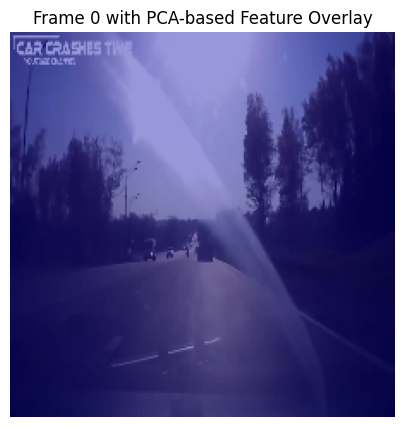

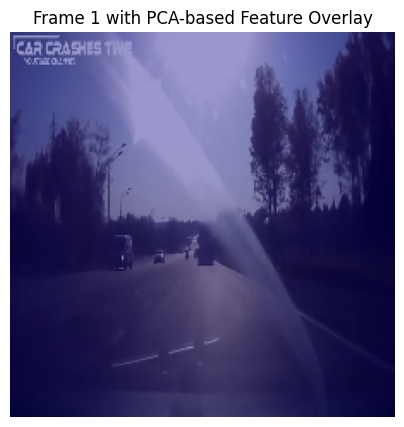

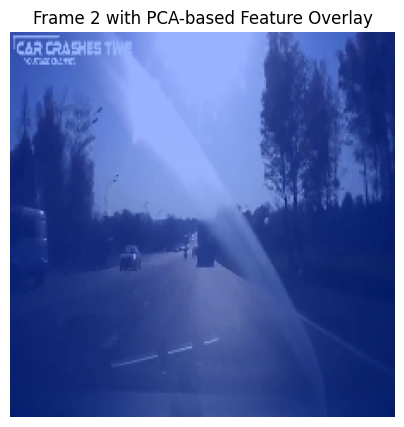

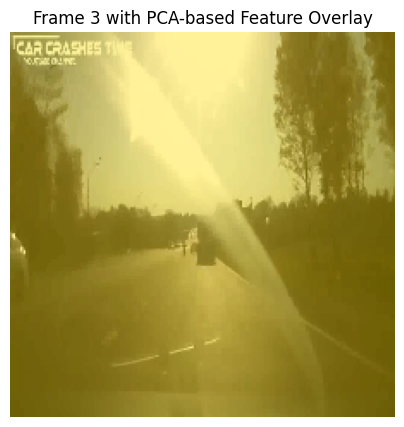

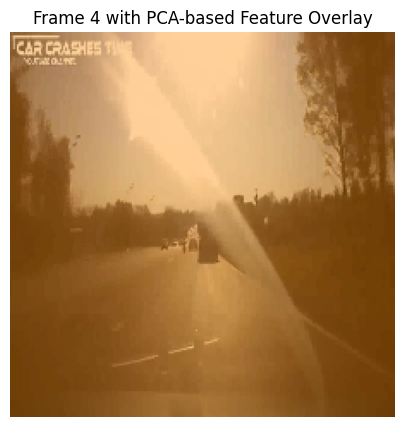

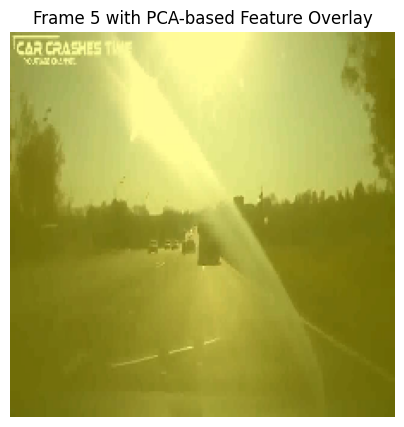

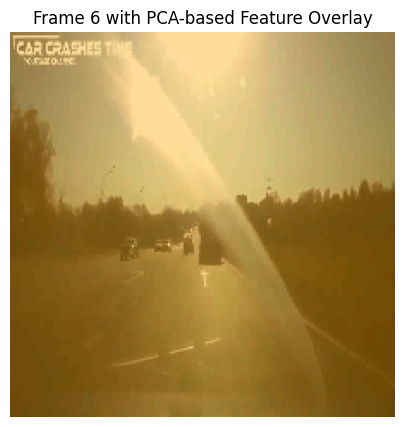

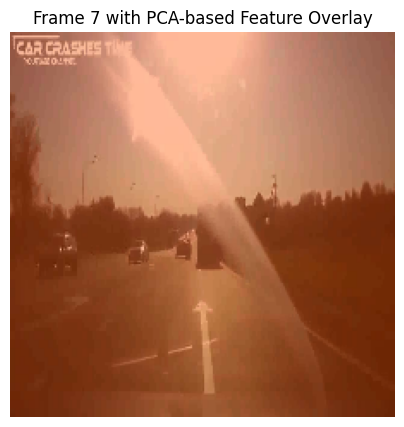

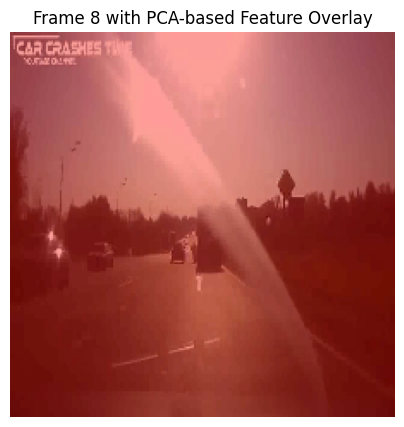

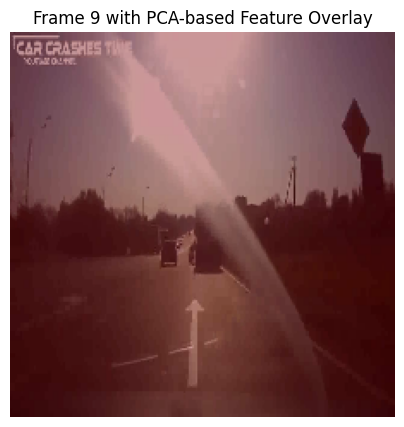

In [39]:
import torch
import torch.nn as nn
import torchvision.models as models
import torchvision.transforms as transforms
import numpy as np
import cv2
import os
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# Load the pre-trained VGG16 model
vgg16 = models.vgg16(pretrained=True)

# Modify the model to remove the classification layers and retain feature extraction layers
class VGG16FeatureExtractor(nn.Module):
    def __init__(self, vgg16):
        super(VGG16FeatureExtractor, self).__init__()
        self.features = vgg16.features
        self.avgpool = vgg16.avgpool
        self.fc = nn.Sequential(
            nn.Linear(25088, 4096),  # VGG16 has a 4096-dim output from the first FC layer
            nn.ReLU(True),
            nn.Dropout(),
            nn.Linear(4096, 2048),  # Reduce to 2048-dim
            nn.ReLU(True),
            nn.Dropout()
        )

    def forward(self, x):
        x = self.features(x)
        x = self.avgpool(x)
        x = torch.flatten(x, 1)
        x = self.fc(x)
        return x

# Instantiate the feature extractor
feature_extractor = VGG16FeatureExtractor(vgg16)
feature_extractor.eval()

# Function to extract frames from a video
def extract_frames(video_path, num_frames=100):
    cap = cv2.VideoCapture(video_path)
    frame_count = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
    interval = max(1, frame_count // num_frames)  # Ensure interval is at least 1
    frames = []

    for i in range(num_frames):
        cap.set(cv2.CAP_PROP_POS_FRAMES, i * interval)
        ret, frame = cap.read()
        if ret:
            frame = cv2.resize(frame, (224, 224))
            frames.append(frame)
        else:
            frames.append(np.zeros((224, 224, 3)))  # Pad with black frames if fewer frames are available

    cap.release()
    frames = np.array(frames)
    return frames

# Function to visualize global features on frames
def visualize_global_features_on_frames(video_path):
    # Extract frames
    frames = extract_frames(video_path, num_frames=10)  # Reduce num_frames for visualization

    # Preprocess the frames
    preprocess = transforms.Compose([
        transforms.ToTensor(),  # Convert to Tensor
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),  # Normalize
    ])

    frames_tensor = torch.stack([preprocess(frame) for frame in frames])  # Stack into a tensor
    frames_tensor = frames_tensor.float()

    # Pass through the VGG16 feature extractor
    with torch.no_grad():
        features = feature_extractor(frames_tensor)

    features_np = features.numpy()

    # Apply PCA to reduce to 2D
    pca = PCA(n_components=2)
    features_2d = pca.fit_transform(features_np)

    # Normalize the features for visualization
    features_2d -= features_2d.min(axis=0)
    features_2d /= features_2d.max(axis=0)

    # Visualize the features as heatmaps on the frames
    for i, frame in enumerate(frames):
        # Scale features to the range [0, 255] and convert to uint8
        heatmap_data = np.uint8(255 * features_2d[i, 0])
        
        # Convert the 1D feature to a 2D heatmap (for visualization purposes)
        heatmap = cv2.applyColorMap(heatmap_data.reshape((1, 1)), cv2.COLORMAP_JET)
        heatmap = cv2.resize(heatmap, (224, 224))
        
        # Overlay the heatmap on the frame
        overlayed_frame = cv2.addWeighted(frame, 0.6, heatmap, 0.4, 0)

        plt.figure(figsize=(5, 5))
        plt.imshow(cv2.cvtColor(overlayed_frame, cv2.COLOR_BGR2RGB))
        plt.title(f'Frame {i} with PCA-based Feature Overlay')
        plt.axis('off')
        plt.savefig("/Users/punsisikiridana/Documents/University_Education/MSc/SEMESTER_2/IN24_S2_CS5801_Advanced_AI/Project/GRAPH/Graph-Graph/data_preparation/VG16/{}.png".format(str(random.randint(1,1000))))



video_path = '/Users/punsisikiridana/Documents/University_Education/MSc/SEMESTER_2/IN24_S2_CS5801_Advanced_AI/Project/GRAPH/Graph-Graph/data_preparation/CCD2/000459.mp4'
visualize_global_features_on_frames(video_path)